In [ ]:
!pip install osmnx
!pip install mapclassify
!pip install networkx==3.4.2
!pip install pydeck

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.6/99.6 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.1/59.1 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 43.0 MB/s eta 0:00:00


In [ ]:
%cd /content/drive/MyDrive/htcl/maps

/content/drive/MyDrive/htcl/maps


In [4]:
import geopandas as gpd
import matplotlib.pyplot as plt
import osmnx as ox

from glob import glob

In [5]:
glob("*json")

['epuletmagassag.geojson']

In [6]:
# parse the building height data set
gdf = gpd.read_file('epuletmagassag.geojson')
len(gdf)

352845

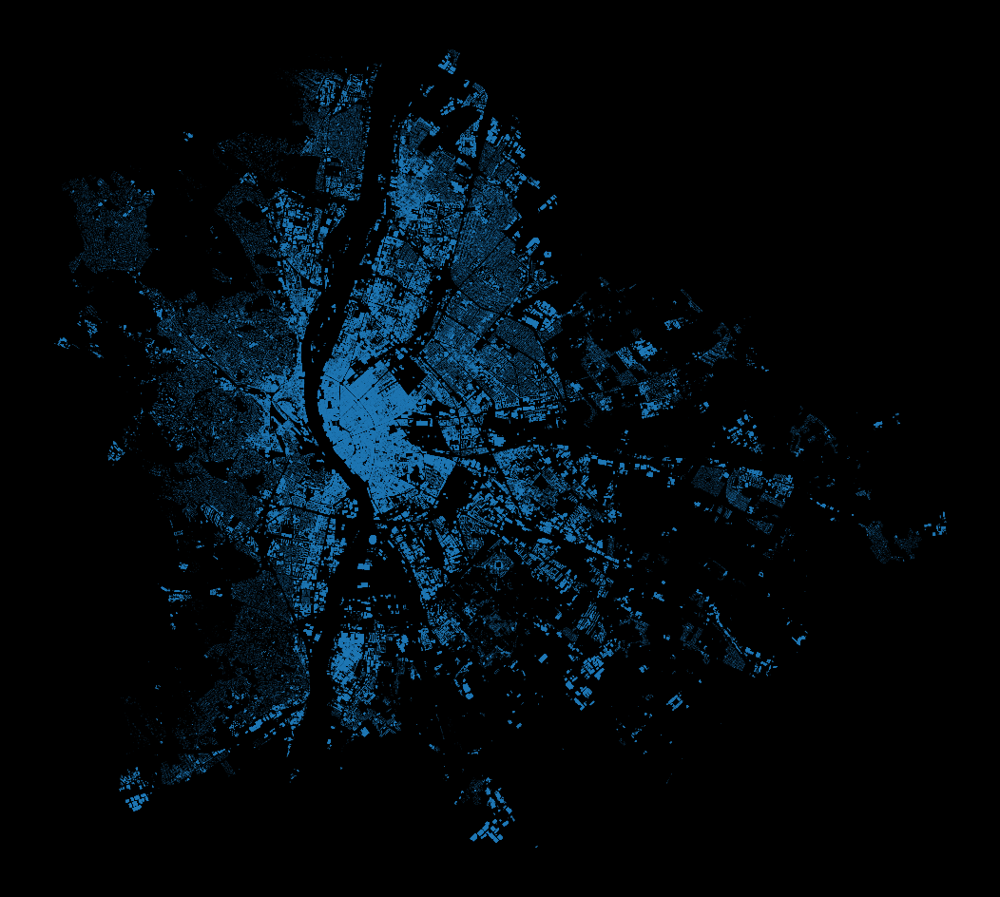

In [7]:
f, ax = plt.subplots(1, 1, figsize=(15, 12))

gdf.plot(ax=ax)

# Set background colors for aesthetic visualization
f.patch.set_facecolor('k')
ax.set_facecolor('k')

ax.axis('off')
f.show()

In [8]:
gdf.head(3)

,fid,osm_id,code,fclass,name,type,fid_2,DN,geometry
0,1,15092527,1500,building,None,parking,264141,9,"POLYGON ((19.01604 47.40561, 19.01728 47.40612..."
1,1,15092527,1500,building,None,parking,264128,10,"POLYGON ((19.01604 47.40561, 19.01728 47.40612..."
2,1,15092527,1500,building,None,parking,263879,10,"POLYGON ((19.01604 47.40561, 19.01728 47.40612..."


In [9]:
ox.geocode_to_gdf

<function osmnx.geocoder.geocode_to_gdf(query: 'str | dict[str, str] | list[str | dict[str, str]]', *, which_result: 'int | None | list[int | None]' = None, by_osmid: 'bool' = False) -> 'gpd.GeoDataFrame'>

<Axes: >

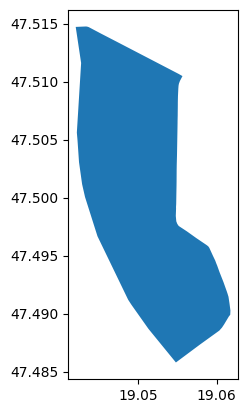

In [10]:
import osmnx as ox

admin = ox.geocode_to_gdf('5th district, Budapest')
admin.plot()

In [15]:
# filter out the bulding footprints that fall into my selected districts
gdf2 = gpd.overlay(gdf, admin).iloc[::3]

len(gdf2)

2754

,DN,name_1
3120,74,Országház
7821,84,Szent István-bazilika


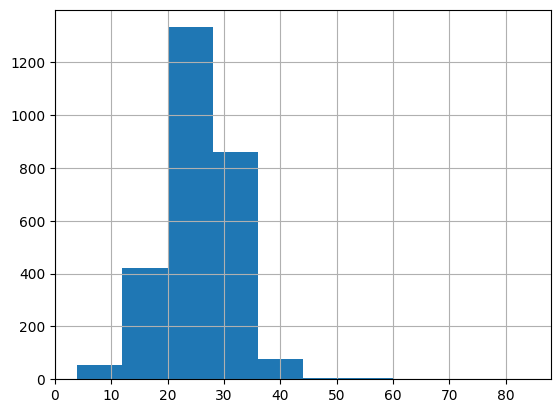

In [16]:
gdf2.DN.hist()
gdf2[gdf2.DN>60][['DN', 'name_1']]

In [ ]:
# Step 1: Reproject to EPSG:23700 (Hungarian national projection)
projected_gdf = gdf2.to_crs("EPSG:23700")

# Step 2: Calculate area in square meters
projected_gdf["area_m2"] = projected_gdf.geometry.area

# Step 4: Display the results
projected_gdf.head()

In [ ]:
projected_gdf.area_m2.hist(bins=50)

In [ ]:
gdf3 = projected_gdf[projected_gdf.area_m2>500]
gdf3.shape

(6720, 27)

In [18]:
import pydeck as pdk

layer = pdk.Layer(
    'PolygonLayer',
    data=gdf2,
    get_polygon='geometry.coordinates',
    extruded=True,
    get_elevation='DN',
    get_fill_color = [255, 0, 0],
)

view_state = pdk.ViewState(
    latitude=47.499919,
    longitude=19.0530236,
    zoom=13,
    pitch=90, # controls the angle of the camera relative to the ground
    bearing = 30 # controls the rotation of the camera around the vertical axis
)

# Create the 3D map
r = pdk.Deck(layers=[layer], initial_view_state=view_state)
r

<IPython.core.display.Javascript object>

{
  "initialViewState": {
    "bearing": 30,
    "latitude": 47.499919,
    "longitude": 19.0530236,
    "pitch": 90,
    "zoom": 13
  },
  "layers": [
    {
      "@@type": "PolygonLayer",
      "data": [
        {
          "DN": 38,
          "addresstype": "borough",
          "bbox_east": 19.061762,
          "bbox_north": 47.5147466,
          "bbox_south": 47.4857856,
          "bbox_west": 19.0420223,
          "class": "boundary",
          "code": 1500,
          "display_name": "5th district, Budapest, Central Hungary, Hungary",
          "fclass": "building",
          "fid": 5,
          "fid_2": 144471,
          "geometry": {
            "coordinates": [
              [
                [
                  19.0470304,
                  47.5021771
                ],
                [
                  19.0474879,
                  47.5022219
                ],
                [
                  19.0474669,
                  47.502335
                ],
                [
                  19.047676,
                  47.5023562
                ],
                [
                  19.0477131,
                  47.5021658
                ],
                [
                  19.0470471,
                  47.5020967
                ],
                [
                  19.0470884,
                  47.5019107
                ],
                [
                  19.0468815,
                  47.5018892
                ],
                [
                  19.046837,
                  47.5020752
                ],
                [
                  19.0467016,
                  47.5020625
                ],
                [
                  19.0466556,
                  47.5022526
                ],
                [
                  19.0470061,
                  47.5022877
                ],
                [
                  19.0470304,
                  47.5021771
                ]
              ]
            ],
            "type": "Polygon"
          },
          "importance": 0.4711695423364212,
          "lat": 47.4999448,
          "lon": 19.0505488,
          "name_1": null,
          "name_2": "5th district",
          "osm_id_1": "24024226",
          "osm_id_2": 1606103,
          "osm_type": "relation",
          "place_id": 59133577,
          "place_rank": 18,
          "type_1": "office",
          "type_2": "administrative"
        },
        {
          "DN": 37,
          "addresstype": "borough",
          "bbox_east": 19.061762,
          "bbox_north": 47.5147466,
          "bbox_south": 47.4857856,
          "bbox_west": 19.0420223,
          "class": "boundary",
          "code": 1500,
          "display_name": "5th district, Budapest, Central Hungary, Hungary",
          "fclass": "building",
          "fid": 5,
          "fid_2": 144043,
          "geometry": {
            "coordinates": [
              [
                [
                  19.0470304,
                  47.5021771
                ],
                [
                  19.0474879,
                  47.5022219
                ],
                [
                  19.0474669,
                  47.502335
                ],
                [
                  19.047676,
                  47.5023562
                ],
                [
                  19.0477131,
                  47.5021658
                ],
                [
                  19.0470471,
                  47.5020967
                ],
                [
                  19.0470884,
                  47.5019107
                ],
                [
                  19.0468815,
                  47.5018892
                ],
                [
                  19.046837,
                  47.5020752
                ],
                [
                  19.0467016,
                  47.5020625
                ],
                [
                  19.0466556,
                  47.5022526
                ],
                [
                  19.0470061

In [ ]:
import math

# do the scaling
max_val = max(gdf2.DN)
gdf2['scaled'] = [0.2 + (d/max_val) for d in gdf2.DN.to_list()]

# add the data
layer = pdk.Layer(
    'PolygonLayer',
    data=gdf2,
    get_polygon='geometry.coordinates',
    extruded=True,
    get_elevation='DN',
    elevation_scale=4,
    get_line_color=[255, 255, 255],
    get_fill_color="[255, 0, scaled * 255]"

)

# set the view state
view_state = pdk.ViewState(
    latitude=47.499919,
    longitude=19.0530236,
    zoom=13,
)

# Create the 3D map
r = pdk.Deck(layers=[layer], initial_view_state=view_state)
r

In [ ]:
# import math

# # do the scaling
# max_val = max(gdf2.DN)
# gdf2['scaled'] = [0.2 + (d/max_val) for d in gdf2.DN.to_list()]

# # add the data
# layer = pdk.Layer(
#     'PolygonLayer',
#     data=gdf2,
#     get_polygon='geometry.coordinates',
#     extruded=True,
#     get_elevation='DN',
#     elevation_scale=4,
#     get_line_color=[255, 255, 255],
#     get_fill_color="[255, 0, scaled * 255]"

# )


# # set the view state
# view_state = pdk.ViewState(
#     latitude=47.499919,
#     longitude=19.0530236,
#     zoom=14,
#     pitch=90, # controls the angle of the camera relative to the ground
#     bearing = 30 # controls the rotation of the camera around the vertical axis

# )

# # Create the 3D map
# r = pdk.Deck(layers=[layer], initial_view_state=view_state)
# r